In [1]:
import pandas as pd
import numpy as np

%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
# from geopy.distance import vincenty
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
import matplotlib.cm as cm
from scipy.spatial.distance import cdist, pdist
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from datetime import datetime
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')

import copy
import json
import math
from collections import OrderedDict
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
redfin_df = pd.read_csv('redfin_2022-11-03-08-46-51.csv')

redfin_df.rename(columns = {'SALE TYPE':'sale_type', 
                    'SOLD DATE':'sold_date',
                    'PROPERTY TYPE':'property_type', 
                    'STATE OR PROVINCE':'state_or_province',
                    'ZIP OR POSTAL CODE':'zip_or_postal_code', 
                    'SQUARE FEET':'square_feet',
                    'LOT SIZE':'lot_size', 
                    'YEAR BUILT':'year_built',
                    'DAYS ON MARKET':'days_on_market', 
                    '$/SQUARE FEET':'cost_per_sq_ft',
                    'HOA/MONTH':'hoa_per_month',
                    'NEXT OPEN HOUSE START TIME' : 'next_open_house_start_time',
                    'NEXT OPEN HOUSE END TIME' : 'next_open_house_end_time',
                    'URL (SEE https://www.redfin.com/buy-a-home/comparative-market-analysis FOR INFO ON PRICING)' : 'url',
                    'MLS#' : 'mls_num'
                    }, inplace = True)

redfin_df= redfin_df.rename(columns=str.lower)


In [3]:
def clean_redfin_df(redfin_df, columns=False):
    redfin_df_copy = redfin_df.copy()
    redfin_df_copy=redfin_df_copy[columns]
    
    redfin_df_copy = redfin_df_copy.dropna()
    
    return redfin_df_copy

columns=['property_type', 'beds', 'baths', 'square_feet', 'year_built', 'latitude', 'longitude', 'price']

# 'property_type', 'beds', 'baths', 'square_feet', 'year_built', 'month_sold', 'year_sold'

# training has to include response

cleaned_redfin_df = clean_redfin_df(redfin_df, columns)

In [4]:
redfin_df.columns

Index(['sale_type', 'sold_date', 'property_type', 'address', 'city',
       'state_or_province', 'zip_or_postal_code', 'price', 'beds', 'baths',
       'location', 'square_feet', 'lot_size', 'year_built', 'days_on_market',
       'cost_per_sq_ft', 'hoa_per_month', 'status',
       'next_open_house_start_time', 'next_open_house_end_time', 'url',
       'source', 'mls_num', 'favorite', 'interested', 'latitude', 'longitude'],
      dtype='object')

In [5]:
# https://medium.com/analytics-vidhya/clustering-geo-location-dbscan-cadb33b0442e
# https://stackoverflow.com/questions/64201704/trying-to-do-a-plot-with-folium-circlemaker

import folium
from folium import plugins

m = folium.Map(location=[pd.to_numeric(cleaned_redfin_df['latitude']).mean(),pd.to_numeric(cleaned_redfin_df['longitude']).mean()], zoom_start=12, 
               tiles='OpenStreet Map')

for _, row in cleaned_redfin_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color='blue'
    ).add_to(m)
    
m.add_children(plugins.HeatMap(cleaned_redfin_df[['latitude', 'longitude']].to_numpy(), radius=15))

m

In [6]:
X = cleaned_redfin_df[['latitude', 'longitude']].values

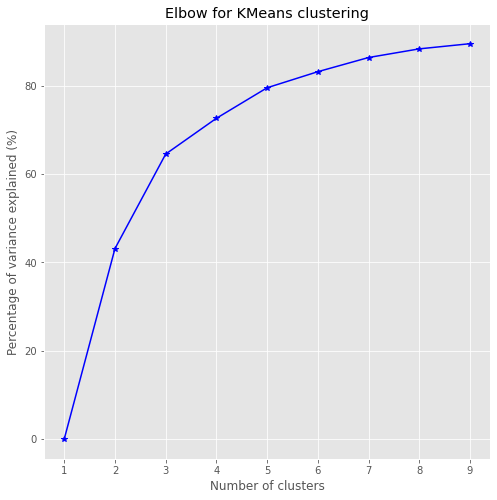

In [7]:
# Clustering with kmeaans
# Source: https://chih-ling-hsu.github.io/2018/01/02/clustering-python#a-2-clusters-of-different-temporal-spatial-weighting

Ks = range(1, 10)
kmean = [KMeans(n_clusters=i).fit(X) for i in Ks]


def plot_elbow(kmean, X):
    centroids = [k.cluster_centers_ for k in kmean]
    D_k = [cdist(X, center, 'euclidean') for center in centroids]
    dist = [np.min(D,axis=1) for D in D_k]

    # Total with-in sum of square
    wcss = [sum(d**2) for d in dist]
    tss = sum(pdist(X)**2)/X.shape[0]
    bss = tss-wcss

    plt.subplots(nrows=1, ncols=1, figsize=(8,8))
    ax = plt.subplot(1, 1, 1)
    ax.plot(Ks, bss/tss*100, 'b*-')
    plt.grid(True)
    plt.xlabel('Number of clusters')
    plt.ylabel('Percentage of variance explained (%)')
    plt.title('Elbow for KMeans clustering')
    plt.show()

plot_elbow(kmean, X)

In [8]:
est = [kmean[2], kmean[3]]
cleaned_redfin_df['k_means_cluster_3'] = est[0].predict(X).tolist()
cleaned_redfin_df['k_means_cluster_4'] = est[1].predict(X).tolist()

colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']

In [9]:
m = folium.Map(location=[pd.to_numeric(cleaned_redfin_df['latitude']).mean(),pd.to_numeric(cleaned_redfin_df['longitude']).mean()], zoom_start=12, 
               tiles='OpenStreet Map')

for _, row in cleaned_redfin_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color=colors[row['k_means_cluster_3']]
    ).add_to(m)
    
m

In [10]:
m = folium.Map(location=[pd.to_numeric(cleaned_redfin_df['latitude']).mean(),pd.to_numeric(cleaned_redfin_df['longitude']).mean()], zoom_start=12, 
               tiles='OpenStreet Map')

for _, row in cleaned_redfin_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color=colors[row['k_means_cluster_4']]
    ).add_to(m)
    
m

Test

In [11]:
pd.set_option('display.max_rows', 500)

In [12]:
# DBSCAN clustering
from itertools import product
from sklearn.metrics import silhouette_score

# Euclidean First

eps_values = [2/6371.]
# min_samples = np.arange(940,970,1)
min_samples= [2]
# eps_values = np.arange(0.016,0.018,0.0002) 
# min_samples = np.arange(100,110,1)


dbscan_params = list(product(eps_values, min_samples))

no_of_clusters = []
sil_score = []
epsvalues = []
min_samp = []

for p in dbscan_params:
    dbscan_cluster = DBSCAN(eps=p[0], min_samples=p[1], algorithm='ball_tree', metric='haversine').fit(np.radians(X))
    epsvalues.append(p[0])
    min_samp.append(p[1])
    no_of_clusters.append(len(np.unique(dbscan_cluster.labels_)))
    if(len(np.unique(dbscan_cluster.labels_)) == 1):
        sil_score.append(0)
    else:
        sil_score.append(silhouette_score(X, dbscan_cluster.labels_))

eps_min = list(zip(no_of_clusters, sil_score, epsvalues, min_samp))
eps_min_df = pd.DataFrame(eps_min, columns=['no_of_clusters', 'silhouette_score', 'epsilon_values', 'minimum_points'])
eps_min_df

,no_of_clusters,silhouette_score,epsilon_values,minimum_points
0,1,0,0.000314,2


In [13]:
dbscan_cluster = DBSCAN(eps=2/6371., min_samples=941, algorithm='ball_tree', metric='haversine').fit(np.radians(X))
print(silhouette_score(X, dbscan_cluster.labels_))
print(len(np.unique(dbscan_cluster.labels_)))

cleaned_redfin_df['dbscan_cluster'] = dbscan_cluster.labels_ + 1

0.33458096473707605
2


In [14]:
m = folium.Map(location=[pd.to_numeric(cleaned_redfin_df['latitude']).mean(),pd.to_numeric(cleaned_redfin_df['longitude']).mean()], zoom_start=10, 
               tiles='OpenStreet Map')

for _, row in cleaned_redfin_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,
        color=colors[row['dbscan_cluster']]
    ).add_to(m)
    
m

<AxesSubplot:xlabel='latitude', ylabel='longitude'>

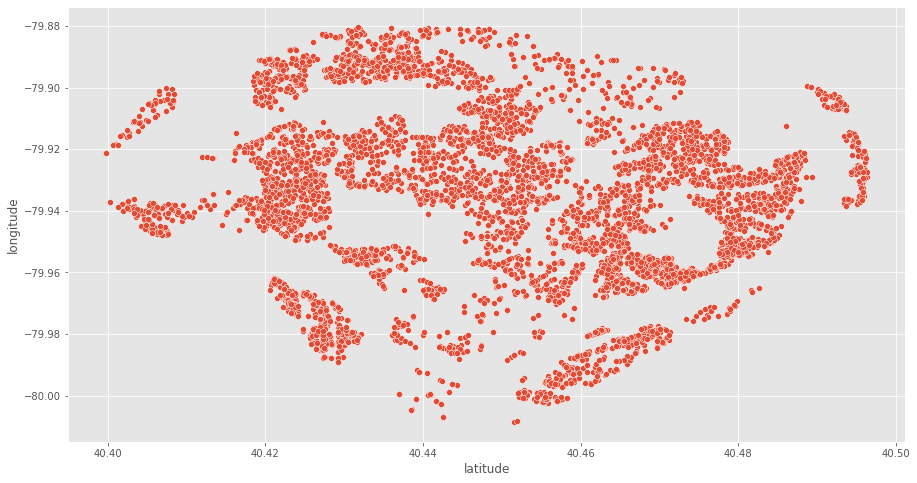

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize = (15,8))
sns.scatterplot(cleaned_redfin_df['latitude'], cleaned_redfin_df['longitude'])

In [16]:
redfin_df['property_type']

0          Multi-Family (2-4 Unit)
1                      Condo/Co-op
2        Single Family Residential
3                      Condo/Co-op
4                      Condo/Co-op
                   ...            
9996     Single Family Residential
9997     Single Family Residential
9998     Single Family Residential
9999     Single Family Residential
10000                          NaN
Name: property_type, Length: 10001, dtype: object

In [17]:
df.head()

NameError: name 'df' is not defined

In [ ]:
len(df['ZIP OR POSTAL CODE'].unique())

In [ ]:
df['ZIP OR POSTAL CODE'].value_counts().to_frame() 

,ZIP OR POSTAL CODE
11375.0,196
10314.0,151
11355.0,147
11354.0,139
11234.0,117
...,...
10069.0,1
10701.0,1
10282.0,1
11239.0,1


Model: ['PROPERTY TYPE', 'ZIP OR POSTAL CODE', 'BEDS', 'BATHS', 'SQUARE FEET', 'YEAR BUILT', 'DAYS ON MARKET'] 

Target: 'PRICE'

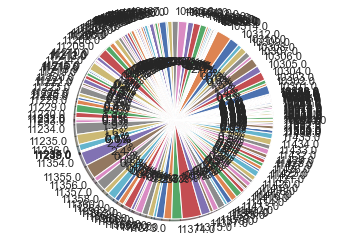

In [ ]:
# zip_count = df['ZIP OR POSTAL CODE'].value_counts()
# sns.set(style="darkgrid")
# sns.barplot(zip_count.index, zip_count.values, alpha=0.9)
# plt.title('Frequency Distribution of Carriers')
# plt.ylabel('Number of Occurrences', fontsize=12)
# plt.xlabel('Carrier', fontsize=12)
# plt.show()

